## 137 - Finding GRIB forecast times and attaching units

[Youtube](https://www.youtube.com/watch?v=-OuSnA9f9qg)

From https://tgftp.nws.noaa.gov/SL.us008001/ST.opnl/DF.gr2/DC.ndfd/AR.conus/VP.001-003/ download file ds.temp.bin



In [1]:
import pygrib
import matplotlib.pyplot as plt
from metpy.units import units
import numpy as np
from datetime import datetime, timedelta

%matplotlib inline

In [2]:
grbs = pygrib.open('./ds.temp.bin')
grb = grbs[1]
grb.units

'K'

In [3]:
temperatures = grb.values
type(temperatures)
temperatures = temperatures * units('kelvin')
temperatures.units

AttributeError: 'MaskedArray' object has no attribute 'units'

In [4]:
temperatures = units('kelvin') * temperatures
temperatures.units
type(temperatures)
temperatures

Magnitude,[[-- -- -- ... -- -- --] [-- -- -- ... -- -- --] [-- -- -- ... -- -- --] ... [-- -- -- ... -- -- --] [-- -- -- ... -- -- --] [-- -- -- ... -- -- --]]
Units,kelvin


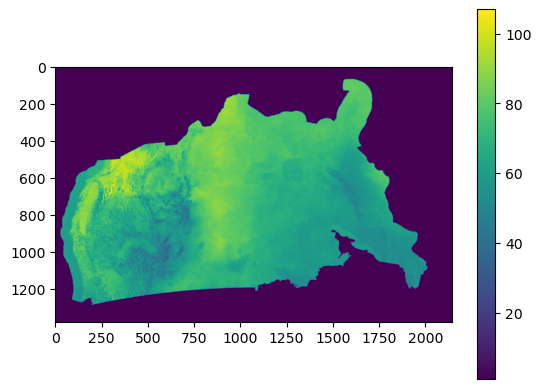

In [5]:
plt.imshow(temperatures.to('degF'))
plt.colorbar()

In [6]:
grbs.seek(0)
for grb in grbs:
 print(grb)

1:2 metre temperature:K (instant):lambert:heightAboveGround:level 2 m:fcst time 1 hrs:from 202209302200
2:2 metre temperature:K (instant):lambert:heightAboveGround:level 2 m:fcst time 2 hrs:from 202209302200
3:2 metre temperature:K (instant):lambert:heightAboveGround:level 2 m:fcst time 3 hrs:from 202209302200
4:2 metre temperature:K (instant):lambert:heightAboveGround:level 2 m:fcst time 4 hrs:from 202209302200
5:2 metre temperature:K (instant):lambert:heightAboveGround:level 2 m:fcst time 5 hrs:from 202209302200
6:2 metre temperature:K (instant):lambert:heightAboveGround:level 2 m:fcst time 6 hrs:from 202209302200
7:2 metre temperature:K (instant):lambert:heightAboveGround:level 2 m:fcst time 7 hrs:from 202209302200
8:2 metre temperature:K (instant):lambert:heightAboveGround:level 2 m:fcst time 8 hrs:from 202209302200
9:2 metre temperature:K (instant):lambert:heightAboveGround:level 2 m:fcst time 9 hrs:from 202209302200
10:2 metre temperature:K (instant):lambert:heightAboveGround:lev

In [7]:
grbs.seek(0)
times = np.array([grb.validDate for grb in grbs])

In [8]:
desired_time = datetime.utcnow() + timedelta(hours = 12)

In [9]:
delta_times = times - desired_time
delta_times

array([datetime.timedelta(days=-1, seconds=40513, microseconds=89347),
       datetime.timedelta(days=-1, seconds=44113, microseconds=89347),
       datetime.timedelta(days=-1, seconds=47713, microseconds=89347),
       datetime.timedelta(days=-1, seconds=51313, microseconds=89347),
       datetime.timedelta(days=-1, seconds=54913, microseconds=89347),
       datetime.timedelta(days=-1, seconds=58513, microseconds=89347),
       datetime.timedelta(days=-1, seconds=62113, microseconds=89347),
       datetime.timedelta(days=-1, seconds=65713, microseconds=89347),
       datetime.timedelta(days=-1, seconds=69313, microseconds=89347),
       datetime.timedelta(days=-1, seconds=72913, microseconds=89347),
       datetime.timedelta(days=-1, seconds=76513, microseconds=89347),
       datetime.timedelta(days=-1, seconds=80113, microseconds=89347),
       datetime.timedelta(days=-1, seconds=83713, microseconds=89347),
       datetime.timedelta(seconds=913, microseconds=89347),
       datetime.t

In [10]:
idx_min = np.argmin(np.abs(delta_times))
idx_min
times[idx_min]

datetime.datetime(2022, 10, 1, 12, 0)

In [11]:
desired_time

datetime.datetime(2022, 10, 1, 11, 44, 46, 910653)

In [12]:
type(idx_min)

numpy.int64

In [13]:
grbs.seek(0)
grb = grbs[int(idx_min) + 1]
grb.validDate

datetime.datetime(2022, 10, 1, 12, 0)